<a href="https://colab.research.google.com/github/Sandeep-4469/Chexpert_solution/blob/main/Chexpert_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
mimsadiislam_chexpert_path = kagglehub.dataset_download('mimsadiislam/chexpert')

print('Data source import complete.')


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from PIL import Image
from torchvision.utils import make_grid
import torchvision.transforms.functional as TF
import albumentations as A
from albumentations.pytorch import ToTensorV2
from tqdm.auto import tqdm
from sklearn.model_selection import StratifiedGroupKFold
from pathlib import Path
from collections import Counter
import datasets
from transformers import AutoModelForImageClassification, Trainer, TrainingArguments
from torchmetrics.functional.classification import (multilabel_auroc,
                                                    multilabel_exact_match,
                                                    multilabel_specificity,
                                                    multilabel_hamming_distance
                                                   )
from types import SimpleNamespace
import wandb

tqdm.pandas()

/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.17). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [ ]:
base_path = Path('/kaggle/input/chexpert')

In [ ]:
train_df = pd.read_csv('/kaggle/input/chexpert/CheXpert-v1.0-small/train.csv')
valid_df = pd.read_csv('/kaggle/input/chexpert/CheXpert-v1.0-small/valid.csv')

train_df['Path'] = train_df['Path'].progress_map(lambda p: base_path/Path(p))
valid_df['Path'] = valid_df['Path'].progress_map(lambda p: base_path/Path(p))

  0%|          | 0/223414 [00:00<?, ?it/s]

  0%|          | 0/234 [00:00<?, ?it/s]

In [ ]:
train_df['Path']

0         /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
1         /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
2         /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
3         /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
4         /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
                                ...                        
223409    /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
223410    /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
223411    /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
223412    /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
223413    /kaggle/input/chexpert/CheXpert-v1.0-small/tra...
Name: Path, Length: 223414, dtype: object

In [ ]:
basic_tfms = A.Compose([
    A.Resize(320,320),
    ToTensorV2()
])

In [ ]:
def open_im(p):
    im = Image.open(p).convert('RGB')
    return np.array(im)


def show(imgs,suptitle='Samples'):
    plt.rcParams["figure.figsize"] = [12,12]
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = TF.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
    plt.suptitle(suptitle,y=0.9,fontsize=12)
    plt.show()

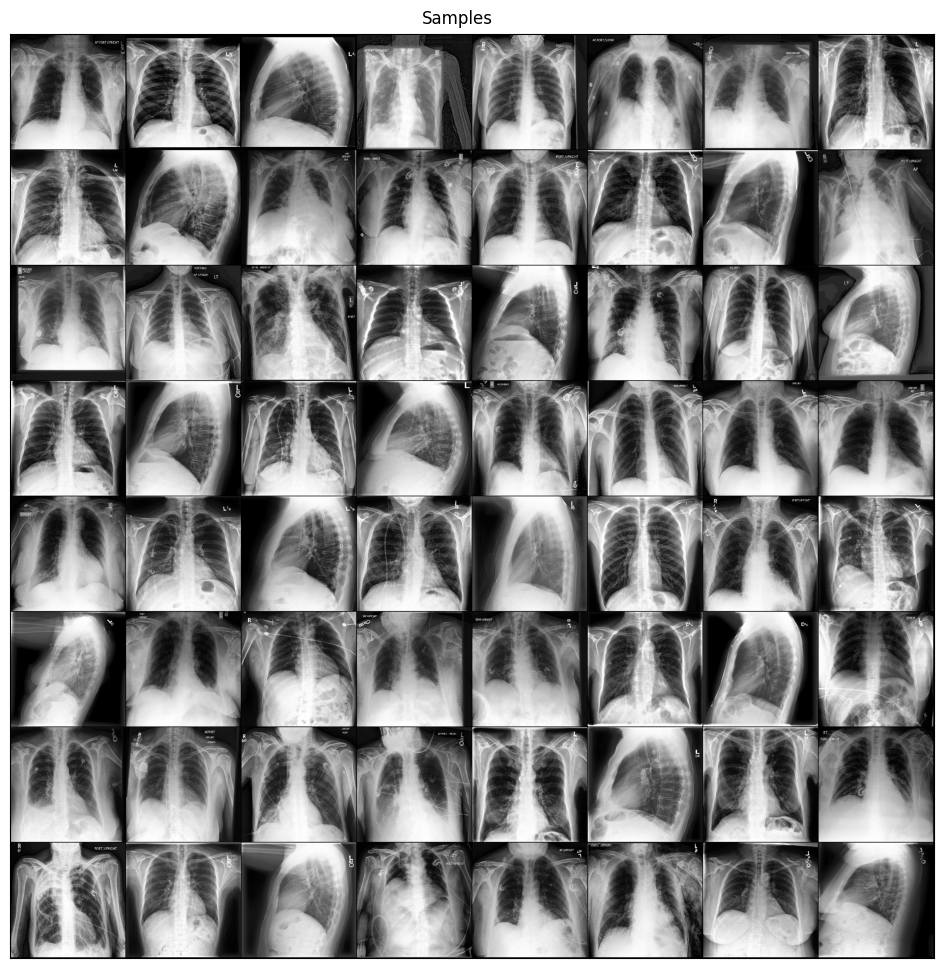

In [ ]:
samples = [basic_tfms(image=open_im(valid_df['Path'][i]))['image'] for i in range(64)]
g=make_grid(samples, nrow=8)
show(g)
plt.show()

In [ ]:
all_target_cols = [
    'No Finding',
    'Enlarged Cardiomediastinum', 'Cardiomegaly', 'Lung Opacity',
    'Lung Lesion', 'Edema', 'Consolidation', 'Pneumonia', 'Atelectasis',
    'Pneumothorax', 'Pleural Effusion', 'Pleural Other', 'Fracture',
    'Support Devices'
]
target_cols = ['No Finding', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Pleural Effusion']



keep_cols = ['Path'] + target_cols

In [ ]:
train_df[keep_cols].head()

,Path,No Finding,Atelectasis,Cardiomegaly,Consolidation,Edema,Pleural Effusion
0,/kaggle/input/chexpert/CheXpert-v1.0-small/tra...,1.0,NaN,NaN,NaN,NaN,NaN
1,/kaggle/input/chexpert/CheXpert-v1.0-small/tra...,NaN,-1.0,-1.0,-1.0,-1.0,-1.0
2,/kaggle/input/chexpert/CheXpert-v1.0-small/tra...,NaN,NaN,NaN,-1.0,NaN,NaN
3,/kaggle/input/chexpert/CheXpert-v1.0-small/tra...,NaN,NaN,NaN,-1.0,NaN,NaN
4,/kaggle/input/chexpert/CheXpert-v1.0-small/tra...,NaN,NaN,NaN,NaN,1.0,NaN


In [ ]:
train_df.groupby(['Frontal/Lateral'])['AP/PA'].value_counts()

Frontal/Lateral  AP/PA
Frontal          AP       161590
                 PA        29420
                 LL           16
                 RL            1
Name: count, dtype: int64

In [ ]:
for col in target_cols:
    print(train_df[col].value_counts(dropna=False))
    print('----\n\n')

No Finding
NaN    201033
1.0     22381
Name: count, dtype: int64
----


Atelectasis
 NaN    154971
-1.0     33739
 1.0     33376
 0.0      1328
Name: count, dtype: int64
----


Cardiomegaly
 NaN    177211
 1.0     27000
 0.0     11116
-1.0      8087
Name: count, dtype: int64
----


Consolidation
 NaN    152792
 0.0     28097
-1.0     27742
 1.0     14783
Name: count, dtype: int64
----


Edema
 NaN    137458
 1.0     52246
 0.0     20726
-1.0     12984
Name: count, dtype: int64
----


Pleural Effusion
 NaN    90203
 1.0    86187
 0.0    35396
-1.0    11628
Name: count, dtype: int64
----




In [ ]:
train_df.fillna(value=0,inplace=True)
valid_df.fillna(value=0,inplace=True)


train_df[all_target_cols] = train_df[all_target_cols].astype(int)
valid_df[all_target_cols] = valid_df[all_target_cols].astype(int)

In [ ]:
train_df = train_df.drop(columns=[c for c in train_df.columns if c not in keep_cols])
valid_df = valid_df.drop(columns=[c for c in valid_df.columns if c not in keep_cols])

In [ ]:
train_df.shape, valid_df.shape

((223414, 7), (234, 7))

In [ ]:
for l in [-1,0,1]:
    print(l)
    print(train_df[train_df[target_cols]==l][target_cols].count(),'\n')

-1
No Finding              0
Atelectasis         33739
Cardiomegaly         8087
Consolidation       27742
Edema               12984
Pleural Effusion    11628
dtype: int64 

0
No Finding          201033
Atelectasis         156299
Cardiomegaly        188327
Consolidation       180889
Edema               158184
Pleural Effusion    125599
dtype: int64 

1
No Finding          22381
Atelectasis         33376
Cardiomegaly        27000
Consolidation       14783
Edema               52246
Pleural Effusion    86187
dtype: int64 



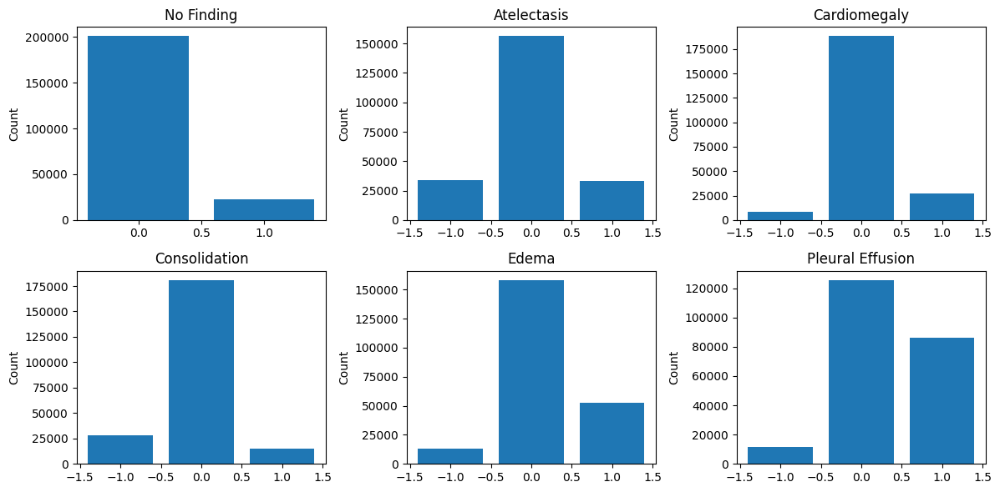

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(12, 6))
for ax, col in zip(axes.flat, target_cols):
    data = train_df[col].value_counts().to_dict()
    ax.bar(data.keys(), data.values())
    ax.set_title(col)
    ax.set_ylabel('Count')
plt.tight_layout()
plt.show()

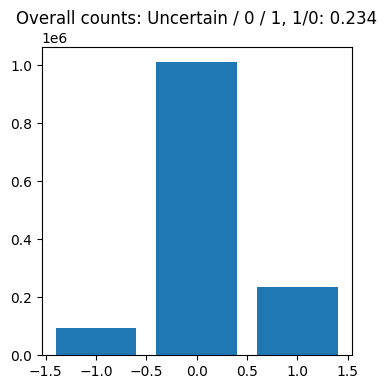

In [ ]:
plt.figure(figsize=(4,4))
all_counts = Counter(train_df[target_cols].values.flatten().tolist())
plt.bar(x=all_counts.keys(),height=all_counts.values())
plt.title(f'Overall counts: Uncertain / 0 / 1, 1/0: {(all_counts[1] / all_counts[0]):.3f}')
plt.show()

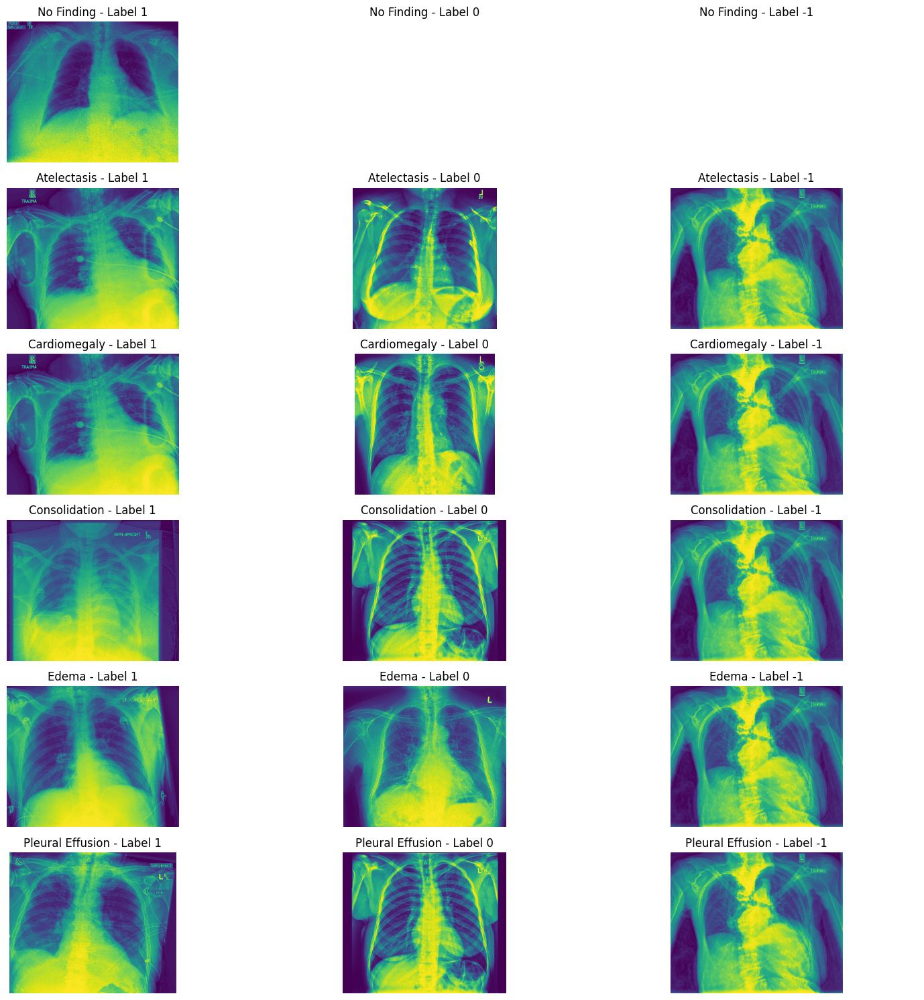

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import pandas as pd
import os

df = pd.read_csv('/kaggle/input/chexpert/CheXpert-v1.0-small/train.csv')

base_dir = '/kaggle/input/chexpert/'

sample_paths = {}

conditions = ["No Finding", "Atelectasis", "Cardiomegaly", "Consolidation", "Edema", "Pleural Effusion"]

label_values = [1.0, 0.0, -1.0]

for condition in conditions:
    sample_paths[condition] = {}

    for label in label_values:
        sample = df[df[condition] == label]

        if not sample.empty:
            image_path = os.path.join(base_dir, sample.iloc[0]['Path'])
            sample_paths[condition][label] = image_path
        else:
            sample_paths[condition][label] = None

fig, axes = plt.subplots(len(conditions), len(label_values), figsize=(15, 15))

axes = axes.flatten()

counter = 0

for condition, paths in sample_paths.items():
    for label, path in paths.items():
        if path is not None:
            img = Image.open(path)
            ax = axes[counter]
            ax.imshow(img)
            ax.set_title(f"{condition} - Label {int(label)}")
            ax.axis('off')
        else:
            axes[counter].axis('off')
            axes[counter].set_title(f"{condition} - Label {int(label)}")

        counter += 1

plt.tight_layout()
plt.show()


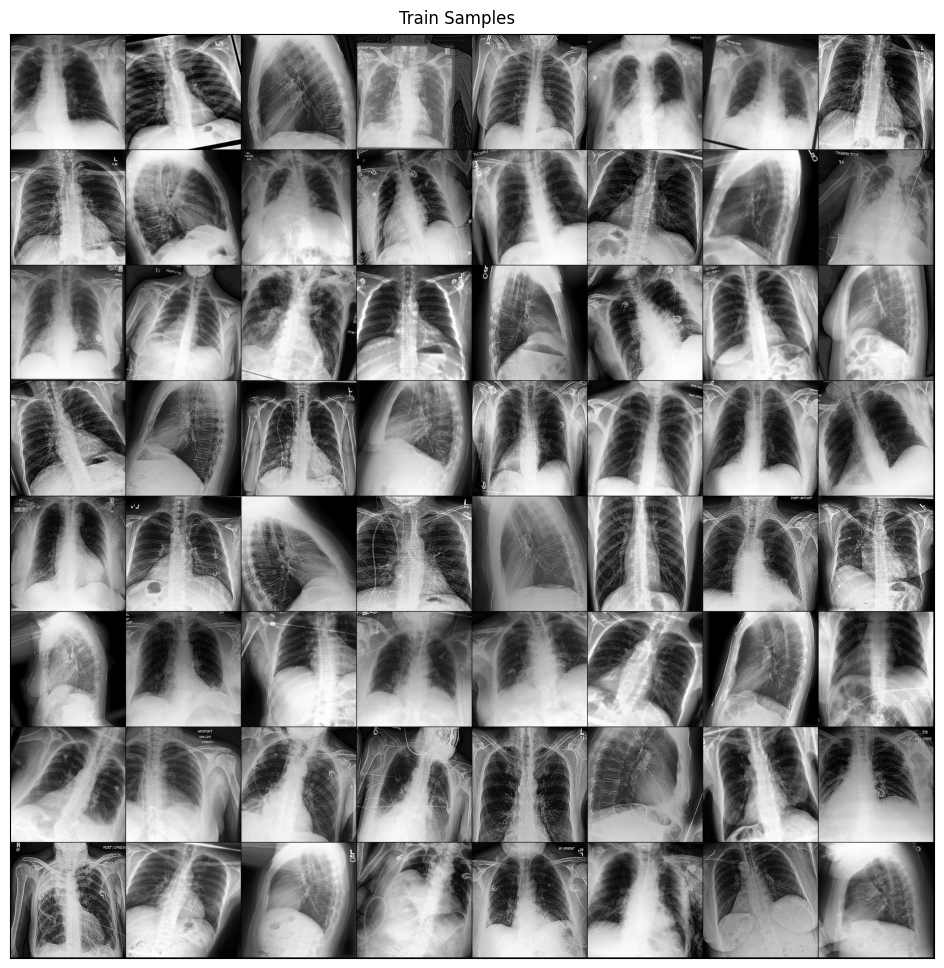

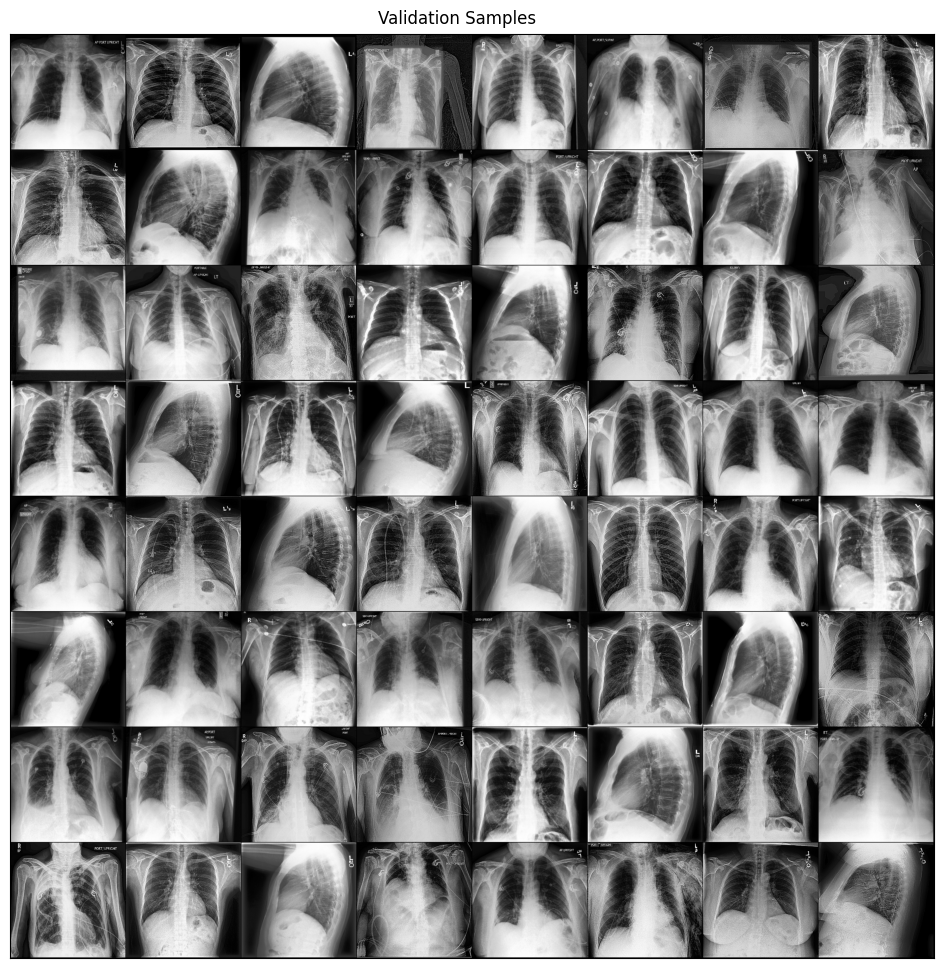

In [ ]:
train_tfms = A.Compose([
    A.Rotate(25),
    A.RandomResizedCrop(384, 384, scale=(0.65, 1.0)),
    A.HorizontalFlip(),
    A.Sharpen(),
    ToTensorV2(),
])

valid_tfms = A.Compose([
    A.Resize(384, 384),
    A.Sharpen(),
    ToTensorV2(),
])
samples = [train_tfms(image=open_im(valid_df['Path'][i]))['image'] for i in range(64)]
g=make_grid(samples, nrow=8)
show(g,suptitle='Train Samples')
print('\n'*5)
samples = [valid_tfms(image=open_im(valid_df['Path'][i]))['image'] for i in range(64)]
g=make_grid(samples, nrow=8)
show(g,suptitle='Validation Samples')

In [ ]:
class Dataset:
    def __init__(self, df, transforms, all_targets=False):
        self.df = df
        self.transforms = transforms
        self.all_targets = all_targets
        self.all_target_cols = [
            'No Finding',
            'Enlarged Cardiomediastinum', 'Cardiomegaly', 'Lung Opacity',
            'Lung Lesion', 'Edema', 'Consolidation', 'Pneumonia', 'Atelectasis',
            'Pneumothorax', 'Pleural Effusion', 'Pleural Other', 'Fracture',
            'Support Devices'
        ]
        self.target_cols = [
            'No Finding',
            'Atelectasis', 'Cardiomegaly',
            'Consolidation', 'Edema', 'Pleural Effusion'
        ]

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        sample = self.df.iloc[idx,:]
        img = Image.open(sample['Path']).convert('L')
        img = np.array(img)
        img = self.transforms(image=img)['image']
        label_cols = self.all_target_cols if self.all_targets else self.target_cols
        labels = torch.tensor(sample[label_cols].tolist()).float()
        return img, labels

In [ ]:
train_ds = Dataset(train_df,train_tfms)

In [ ]:
x,y = train_ds[95]
x.shape, y

(torch.Size([1, 384, 384]), tensor([ 0., -1.,  0.,  0.,  0.,  0.]))

In [ ]:
def show_samples(df,rows,cols,disease):

    R = A.Resize(384,384)
    samples = df[df[disease]==1]['Path'].sample(frac=1).reset_index(drop=True)
    fig = plt.figure(figsize=(cols*4,rows*4))
    # plotting
    for i in range(rows*cols):
        img = R(image=open_im(samples[i]))['image']
        fig.add_subplot(rows,cols,i+1)
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.suptitle(disease,y=1.01,fontsize=20)
    plt.show()

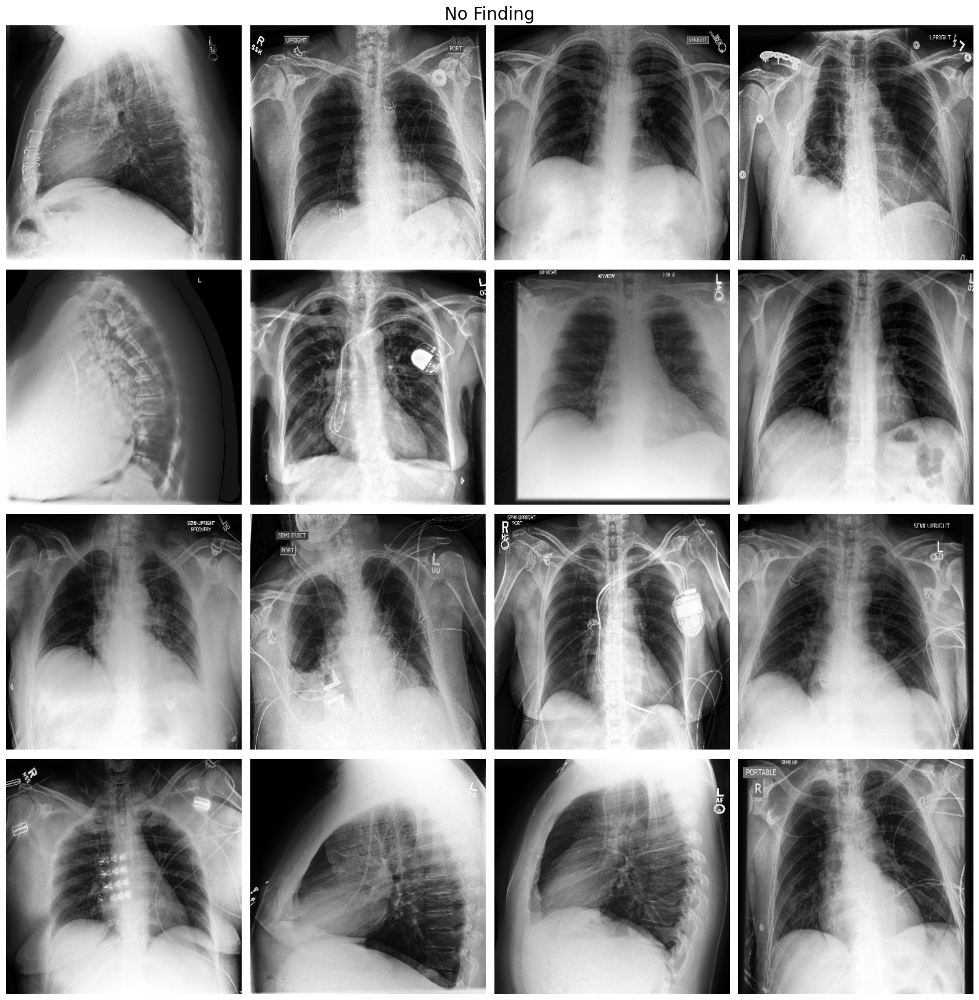

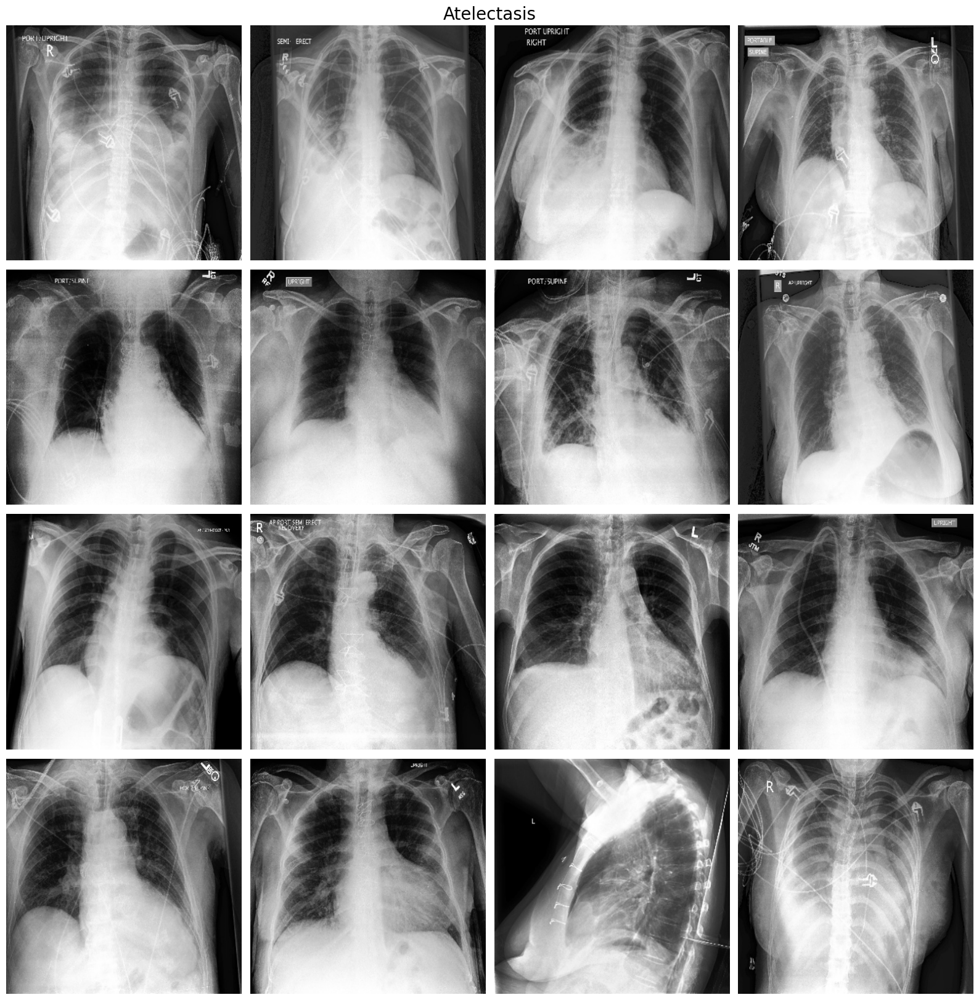

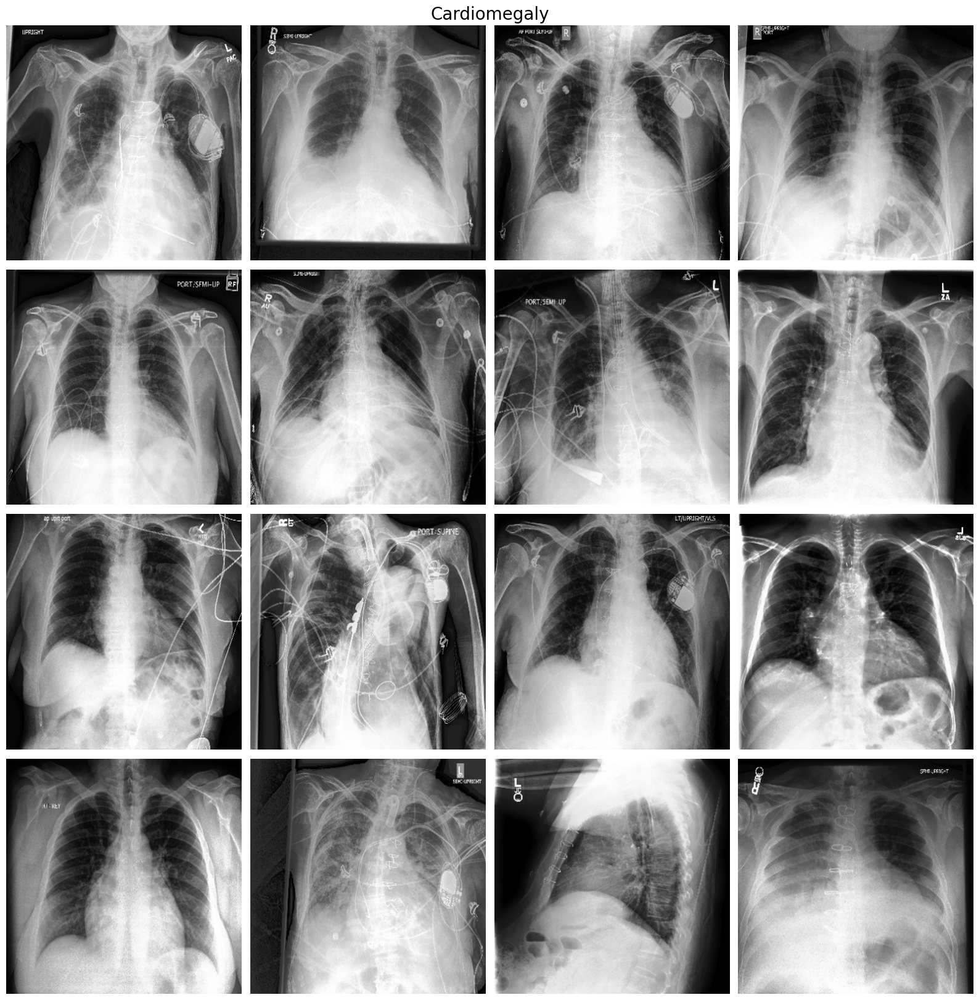

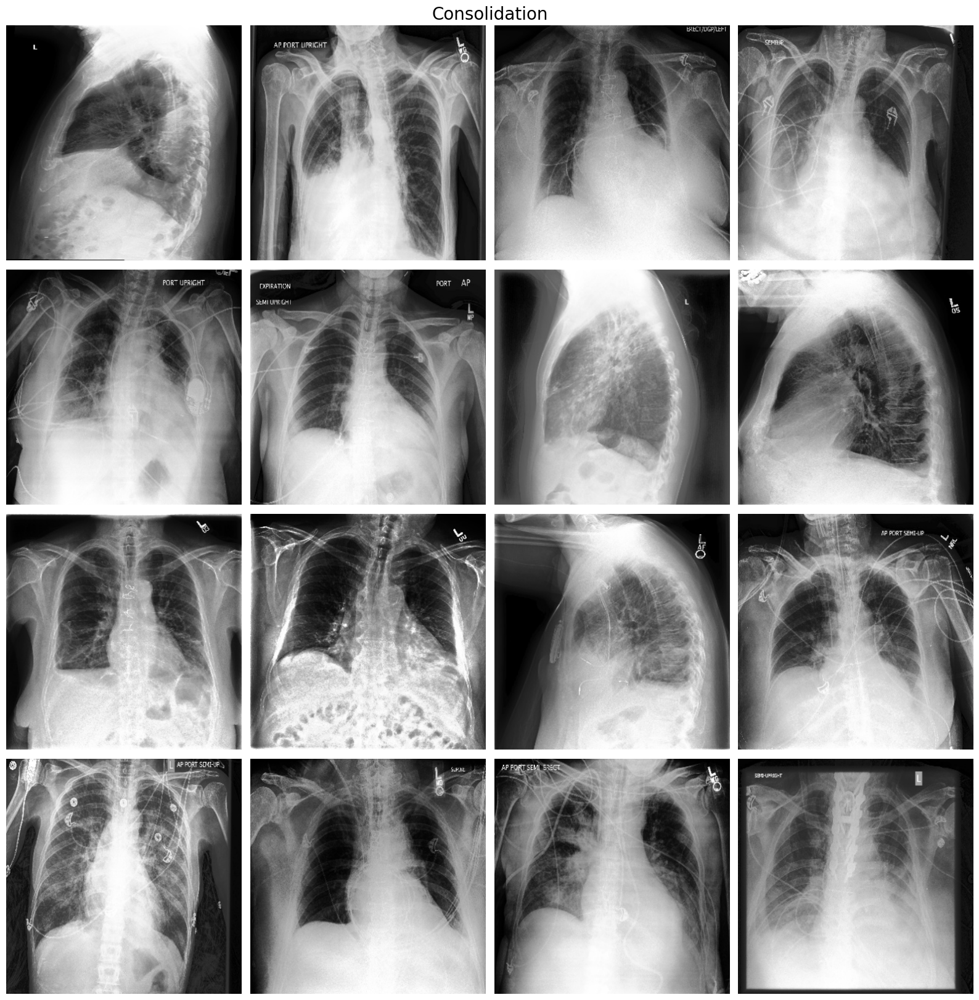

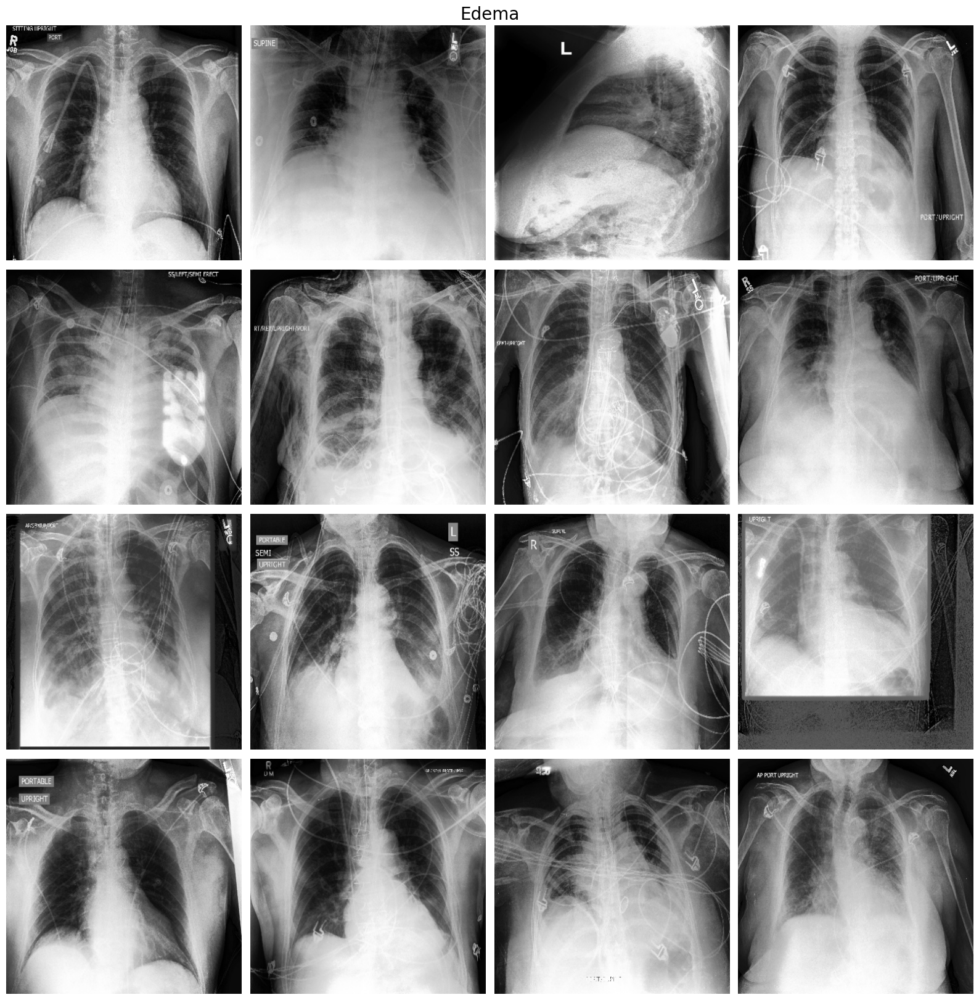

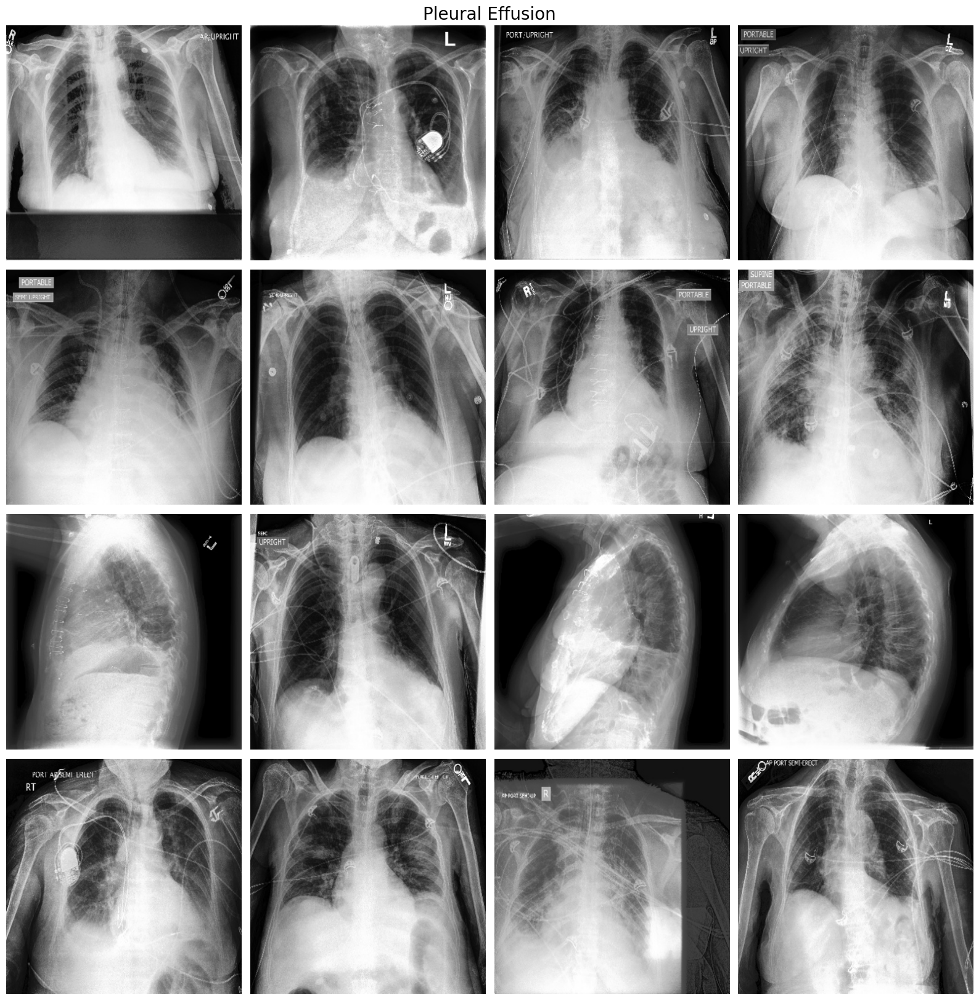

In [ ]:
for d in target_cols:
    show_samples(train_df,4,4,d)
    print('\n'*5)

In [ ]:
valid_ds = Dataset(valid_df,valid_tfms)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [ ]:
from torch.utils.data import DataLoader
train_loader = DataLoader(train_ds, batch_size=32, shuffle=True, num_workers=0)
valid_loader = DataLoader(valid_ds, batch_size=32, shuffle=False, num_workers=0)

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class CheXpertDenseNet(nn.Module):
    def __init__(self, num_classes=6):
        super(CheXpertDenseNet, self).__init__()

        self.model = models.densenet121(pretrained=True)

        self.model.features.conv0 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)

        self.features = self.model.features

        for param in self.features.parameters():
            param.requires_grad = False

        dummy_input = torch.zeros(1, 1, 384, 384)
        dummy_output = self.features(dummy_input)
        flattened_size = dummy_output.numel()

        self.fc1 = nn.Linear(flattened_size, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, num_classes)

        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        x = self.features(x)
        x = torch.flatten(x, 1)
        x = self.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.relu(self.fc2(x))
        x = self.dropout(x)
        x = self.relu(self.fc3(x))
        x = self.fc4(x)
        return x

num_classes = 6
model = CheXpertDenseNet(num_classes=num_classes)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)


In [ ]:
import multiprocessing
multiprocessing.set_start_method('spawn', force=True)

In [ ]:
import os
os.environ['OMP_NUM_THREADS'] = '1'

In [ ]:
torch.cuda.empty_cache()

In [ ]:
import os
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "expandable_segments:True"
import torch